In [1]:
# Due to technical reasons description to this code is
# in a separate txt file (text_to_explain_code.txt).
# loading libraries
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import plotly.express as px

In [3]:
# loading trainD and testD datasets as dataframes
trainD=pd.read_csv("train.csv")
# testD=pd.read_csv("test.csv") # saved for later
trainD.shape


(381109, 12)

In [ ]:
# change dtype to int for data frames trainD and testD, columns 'Policy_Sales_Channel' and 'Region_Code'.
trainD = trainD.astype({'Region_Code':'int', 'Policy_Sales_Channel' : 'int'})
trainD.info()

In [ ]:
# 2. Presence of zeroes or missing values
trainD.notnull().sum()
# there is no missing values as number on cells containing
#  non null data is equal number of rows in trainD df (381109)

/tmp/ipykernel_13402/1016451039.py:8: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig.show()


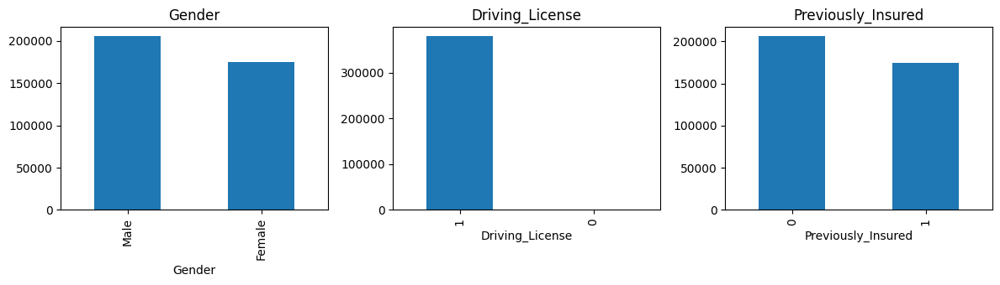

In [6]:
categorical_features1 = ['Gender', 'Driving_License', 'Previously_Insured']
categorical_features2 = ['Vehicle_Age', 'Vehicle_Damage', 'Response']
fig, ax = plt.subplots(1, len(categorical_features1), figsize=(12, 3.5))

for i, categorical_feature1 in enumerate(trainD[categorical_features1]):
    trainD[categorical_feature1].value_counts().plot.bar(ax=ax[i]).set_title(categorical_feature1)
fig.tight_layout()
fig.show()

/tmp/ipykernel_13402/2794161836.py:7: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig.show()


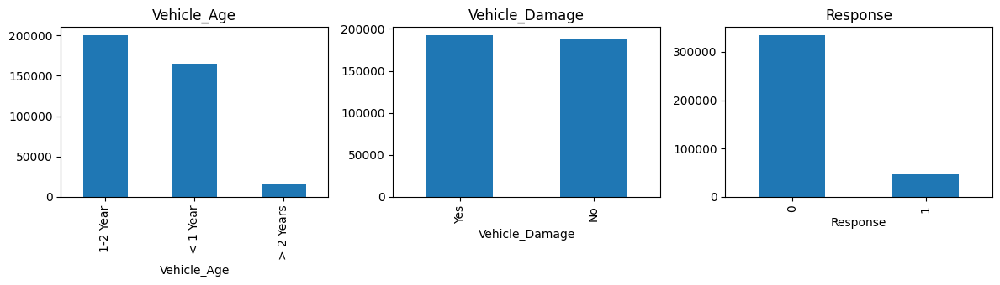

In [7]:
fig, ax = plt.subplots(1, len(categorical_features2), figsize=(12, 3.5))

for i, categorical_feature2 in enumerate(trainD[categorical_features2]):
    trainD[categorical_feature2].value_counts().plot.bar(ax=ax[i]).set_title(categorical_feature2)

fig.tight_layout()
fig.show()

In [8]:
noDL_customers = len(trainD[trainD["Driving_License"]==0])
print("Number of customers who do not have driving licence:", noDL_customers)

Number of customers who do not have driving licence: 812


In [9]:
# counting frequencies:
df_Region=pd.DataFrame(
    trainD.groupby(['Region_Code'])['Region_Code'].value_counts(
    )).rename(columns={'Region_Code': 'RegCode_unique'}
              ).reset_index()

df_Policy=pd.DataFrame(
    trainD.groupby(['Policy_Sales_Channel']
                   )['Policy_Sales_Channel'].value_counts()
    ).rename(columns={'Policy_Sales_Channel': 'Policy_un'}
             ).reset_index()

In [10]:
# Count on Y axis shows great variability.
# To enchance visualization, lets use log for y xis.
fig = px.bar(df_Region, x='Region_Code', y='count',
             width=1200, height=350, log_y=True)

fig.show() # Region 28 process the largest number
# of insurance policies

In [11]:
fig = px.bar(df_Policy, x='Policy_Sales_Channel',
             y='count', width=1200, height=400, log_y=True)

fig.show() # policy sales channels operate with
# drastically different productivity ranging from about 1.5k to about 130k policices sold

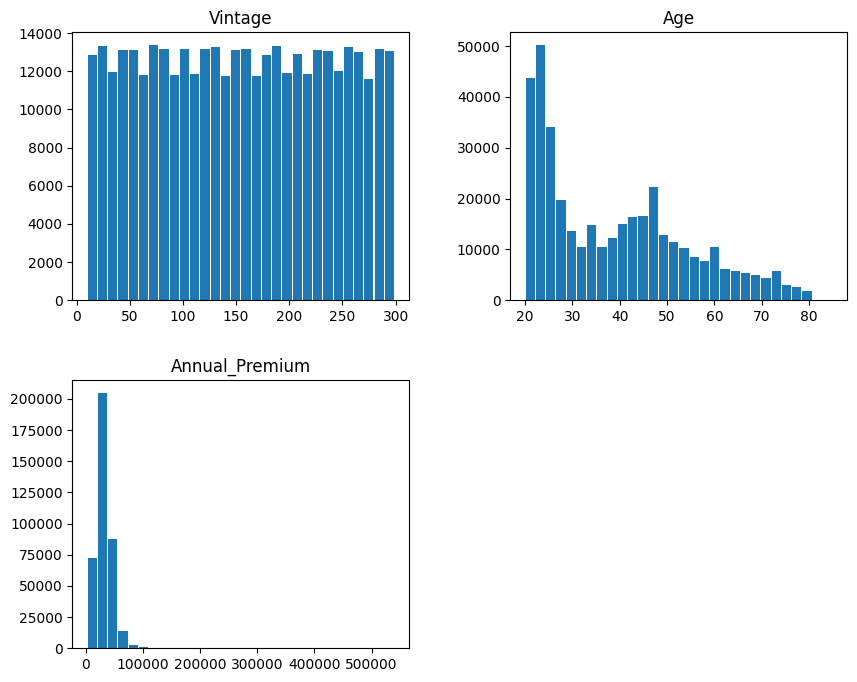

In [12]:
trainD[['Vintage', 'Age','Annual_Premium']].hist(
    bins=30,
    figsize=(10, 8),
    grid = False,
    rwidth = 0.9,
)
plt.show()

In [13]:
fig = px.histogram(trainD, x="Annual_Premium",
                   nbins=300, log_x=True)
fig.show()

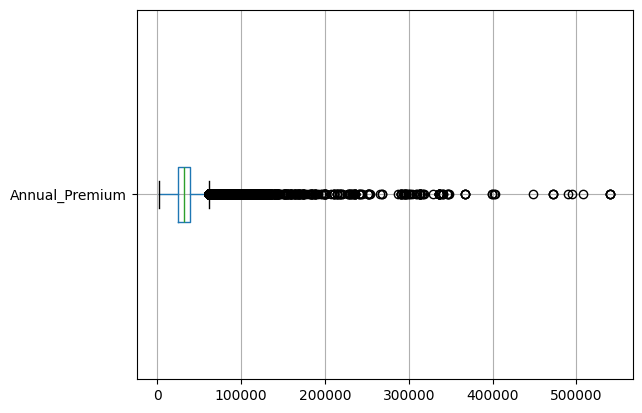

In [14]:
trainD.boxplot(column = ['Annual_Premium'], vert=False)
plt.show() 

In [15]:
Annual_Premium_S=trainD['Annual_Premium'].copy()
Annual_Premium_S.info()

<class 'pandas.core.series.Series'>
RangeIndex: 381109 entries, 0 to 381108
Series name: Annual_Premium
Non-Null Count   Dtype  
--------------   -----  
381109 non-null  float64
dtypes: float64(1)
memory usage: 2.9 MB


In [16]:
fig = px.box(Annual_Premium_S, orientation='h',
             log_x=True, points='all')
 
fig.show()